In [16]:
import numpy as np
%display latex
from scipy import constants

pi = constants.pi
hbar = 1
x, t = var('x', 't')
Psi = var('Psi')
assume(x, 'real')
assume(t, 'real')

$V(x) = \frac12 m\omega^2x^2$  

$\Psi_n(x,t) = \psi_n(x)\phi_n(t)$

$\xi = \sqrt{\frac{m\omega}{\hbar}}x$

$\psi_n(\xi) = (\frac{m\omega}{2\hbar})^{\frac{1}{4}}\frac{1}{\sqrt{2^nn!}}H_n(\xi)e^{-\frac{\xi^2}{2}}$

$H_n(\xi)$ are the Hermite Polynomials

$\phi_n(x) = e^{-i\frac{E_n}{\hbar}t}$

$E_n = (n+\frac12)\hbar\omega$

In [17]:
def H(n,xi):
    H = [1, 2*xi, 4*xi^2-2, 8*xi^3-12*xi, 16*xi^4-48*xi^2+12, 32*xi^5-160*xi^3+120*xi]
    return H[n]

0
1
2
3


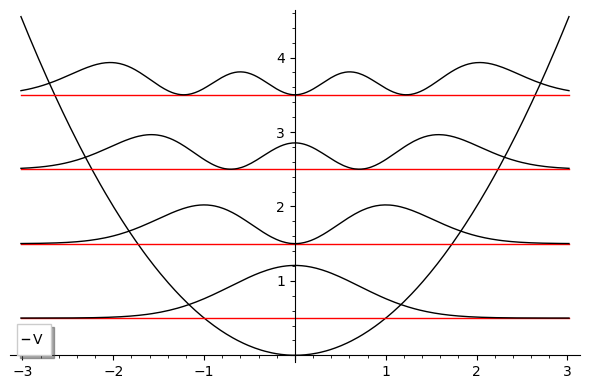

Animation with 1257 frames
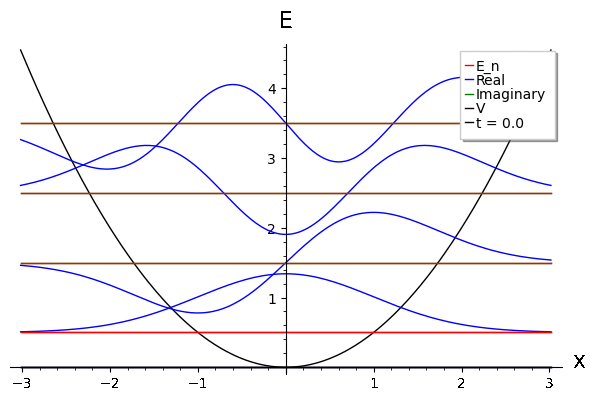

In [20]:
m = 1
w = 1
xi = sqrt((m*w)/(hbar))*x

n_max = 3
E_max = (n_max+0.5)*hbar*w
colors = ['black', 'red', 'blue', 'green']
x_range = (-sqrt(2*1.3*E_max/(m*w^2)),sqrt(2*1.3*E_max/(m*w^2)))

S = plot(0.5*m*w^2*x^2, x_range, color = colors[0], legend_label='V')

P = animate([plot(0, x_range, legend_label = 'E_n', color = colors[1]) + plot(0, x_range, color = colors[2], legend_label = 'Real') + plot(0, x_range, color = colors[3], legend_label = 'Imaginary') for t_val in sxrange(0,(hbar)/(0.5*hbar*w)*2*pi, .01)])
for i in range(len(P)):
    P[i].set_legend_options(loc=1)

P += animate([plot(0.5*m*w^2*x^2, x_range, color = colors[0], legend_label = 'V') + plot(0, x_range, legend_label = 't = ' + str(round(t_val,2)), color = 'black',axes_labels=['x','E']) for t_val in sxrange(0,(hbar)/(0.5*hbar*w)*2*pi, .01)] )

for n in range(n_max+1):
    E = (n+0.5)*hbar*w
    psi = (m*w/(2*hbar))^(1/4)*1/(sqrt(2^n*gamma(n+1)))*H(n,xi)*e^(-0.5*xi^2)
    phi = e^(-I*E*t/hbar)
    
    eqPsi = abs(Psi) == sqrt(psi*phi*psi*phi.conjugate())
    eqRe = Psi == psi*phi.real()
    eqIm = Psi == psi*phi.imag()
    
    S += plot(E, x_range, color = colors[1]) + plot(eqAbs.rhs()+E, x_range, color = 'black')
    P += animate([plot(eqRe.rhs()(t=t_val)+E, x_range, color = colors[2]) + plot(eqIm.rhs()(t=t_val)+E, x_range, color = colors[3]) + plot(E, x_range, color = colors[1]) for t_val in sxrange(0,(hbar)/(0.5*hbar*w)*2*pi, .01)] )
    
show(S)
P.show(delay=2)